In [16]:

import numpy as np
import torch
import torchvision
import  torchvision.transforms as transforms
from PIL import Image
import torchvision.models as models
import matplotlib.pyplot as plt
import os
import random


In [17]:
resnet18 = torchvision.models.resnet18(pretrained=True)
num_classes = 10
resnet18.fc = torch.nn.Linear(in_features=512, out_features=num_classes)

# Load the custom pre-trained weights
weights_path = "Q2/network_visualization.pth"  # Update the path if needed
resnet18.load_state_dict(torch.load(weights_path, map_location=torch.device('cpu')))

# Set model to evaluation mode
resnet18.eval()

print("Model loaded successfully with modified fc layer.")

/home/sid/miniconda3/envs/md-intro-tutorial/lib/python3.13/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/sid/miniconda3/envs/md-intro-tutorial/lib/python3.13/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Model loaded successfully with modified fc layer.


In [18]:
#define transforms to preprocess input image into format expected by model
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
#inverse transform to get normalize image back to original form for visualization
inv_normalize = transforms.Normalize(
    mean=[-0.485/0.229, -0.456/0.224, -0.406/0.255],
    std=[1/0.229, 1/0.224, 1/0.255]
)

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    normalize,          
])


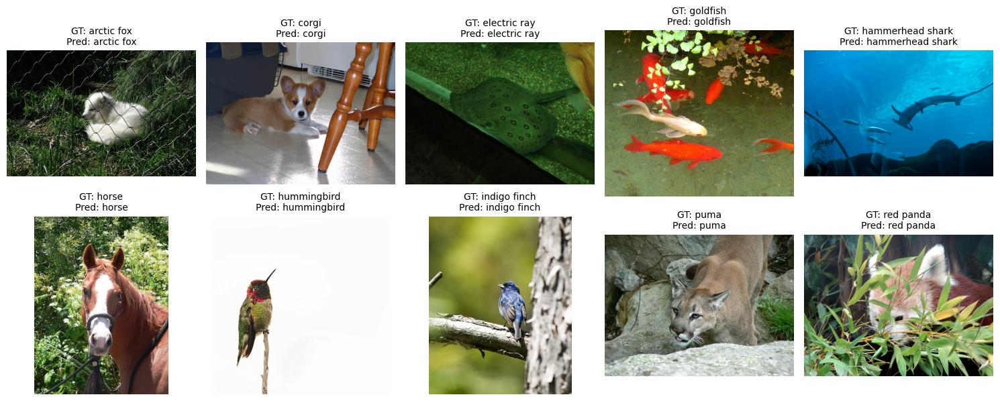

In [19]:
dataset_root = "Q2/network visualization"

class_names = sorted(os.listdir(dataset_root))

# Select one image per class
selected_images = {}

for class_name in class_names:
    class_path = os.path.join(dataset_root, class_name)
    
    if not os.path.isdir(class_path):
        print(f"Skipping {class_name}, not a valid directory.")
        continue  # Skip if not a directory

    # taking first image from each class
    expected_filename = f"{class_name}_1.JPEG"  
    expected_path = os.path.join(class_path, expected_filename)

    if os.path.exists(expected_path):
        selected_images[class_name] = expected_path
    else:
        print(f"Warning: {expected_filename} not found in {class_name}, skipping...")

# Visualize images with ground truth and predicted labels
fig, axes = plt.subplots(2, 5, figsize=(15, 6))  # 2 rows, 5 columns for 10 images

for idx, (class_name, img_path) in enumerate(selected_images.items()):
    img = Image.open(img_path).convert("RGB")
    input_tensor = transform(img).unsqueeze(0)  # Add batch dimension

    # Get model prediction
    with torch.no_grad():
        output = resnet18(input_tensor)
        pred_class = torch.argmax(output, dim=1).item()

    # Plot image
    ax = axes[idx // 5, idx % 5]
    ax.imshow(img)
    ax.set_title(f"GT: {class_name}\nPred: {class_names[pred_class]}", fontsize=10)
    ax.axis("off")

plt.tight_layout()
plt.show()

In [20]:
def saliency(img, model, p = True):
    #we don't need gradients w.r.t. weights for a trained model
    for param in model.parameters():
        param.requires_grad = False
    
    #set model in eval mode
    model.eval()
    #transoform input PIL image to torch.Tensor and normalize
    input = transform(img)
    input.unsqueeze_(0)

    #we want to calculate gradient of higest score w.r.t. input
    #so set requires_grad to True for input 
    input.requires_grad = True
    #forward pass to calculate predictions
    preds = model(input)
    score, indices = torch.max(preds, 1)
    #backward pass to get gradients of score predicted class w.r.t. input image
    score.backward()
    #get max along channel axis
    slc, _ = torch.max(torch.abs(input.grad[0]), dim=0)
    #normalize to [0..1]
    slc = (slc - slc.min())/(slc.max()-slc.min())

    #apply inverse transform on image
    with torch.no_grad():
        input_img = inv_normalize(input[0])
    # Plot image and its saliency map
    if p:
        plt.figure(figsize=(10, 10))
        plt.subplot(1, 2, 1)
        plt.imshow(np.transpose(input_img.detach().numpy(), (1, 2, 0)))
        plt.xticks([])
        plt.yticks([])
        plt.title("Original Image")

        plt.subplot(1, 2, 2)
        plt.imshow(slc.numpy(), cmap=plt.cm.hot)
        plt.xticks([])
        plt.yticks([])
        plt.title("Saliency Map")

        plt.show()
    return slc

Processing arctic fox: Q2/network visualization/arctic fox/arctic fox_1.JPEG


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054133326..1.0658667].


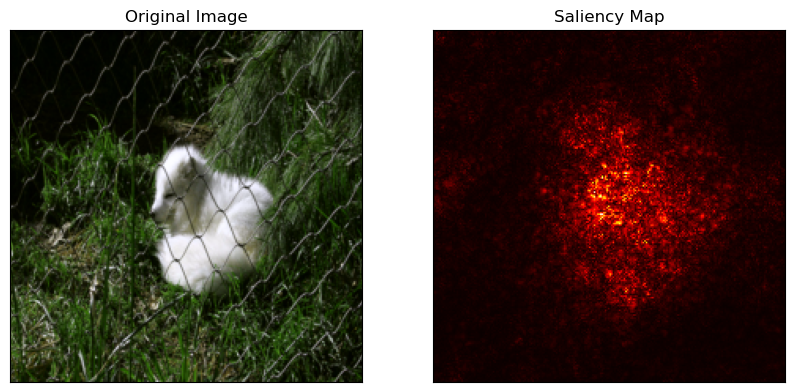

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04079999..1.0792].


Processing corgi: Q2/network visualization/corgi/corgi_1.JPEG


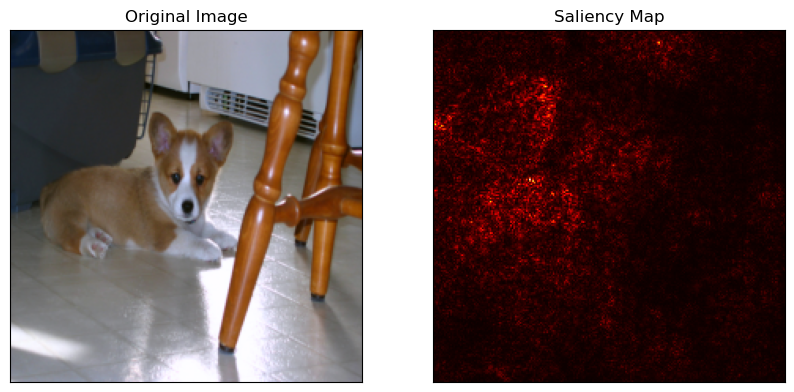

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054133326..0.6666667].


Processing electric ray: Q2/network visualization/electric ray/electric ray_1.JPEG


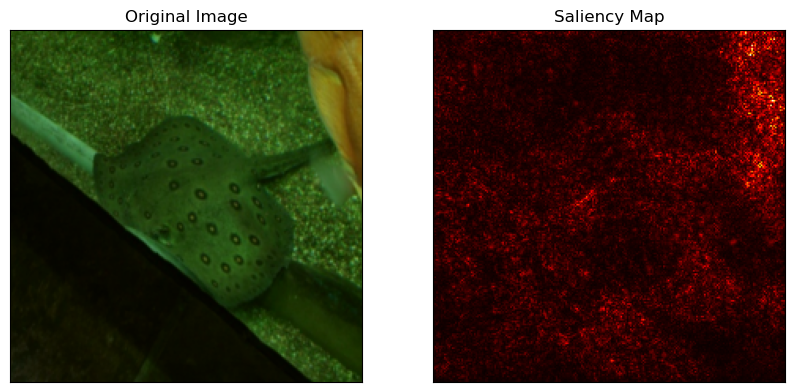

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054133326..1.0792].


Processing goldfish: Q2/network visualization/goldfish/goldfish_1.JPEG


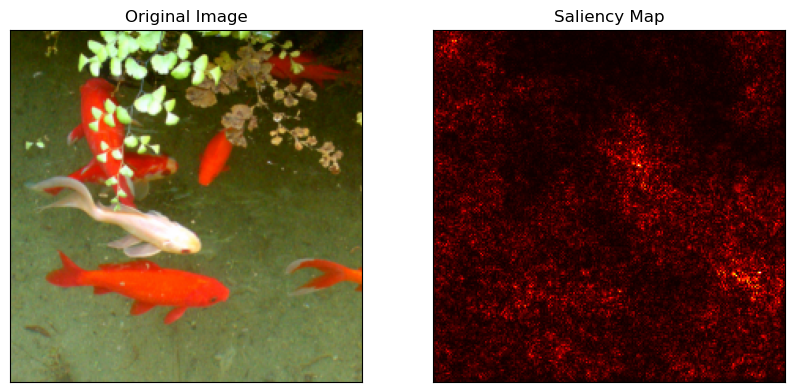

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054133326..1.0614222].


Processing hammerhead shark: Q2/network visualization/hammerhead shark/hammerhead shark_1.JPEG


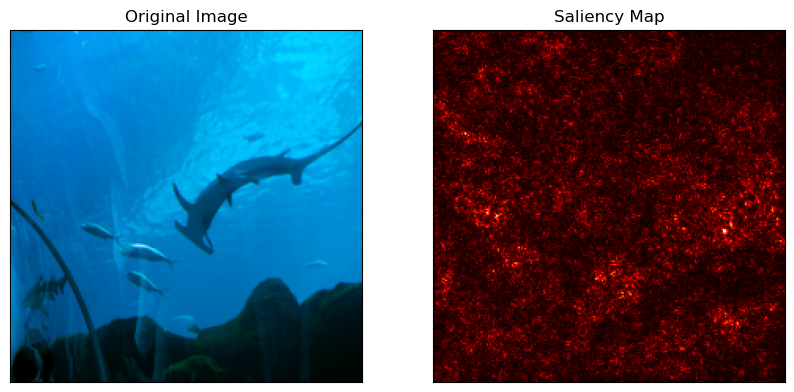

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.045244444..1.0792].


Processing horse: Q2/network visualization/horse/horse_1.JPEG


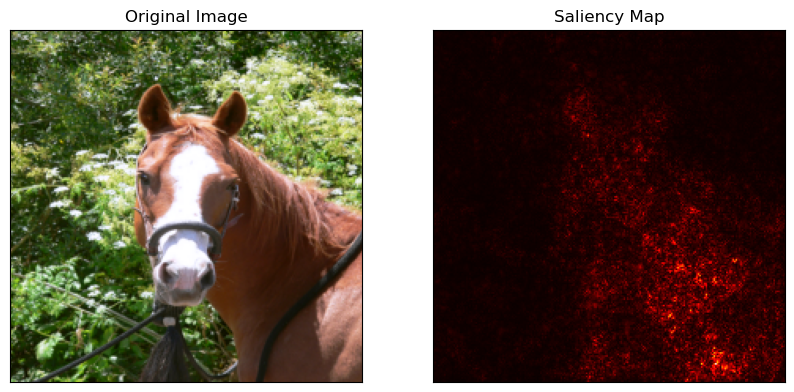

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.039200004..1.0792].


Processing hummingbird: Q2/network visualization/hummingbird/hummingbird_1.JPEG


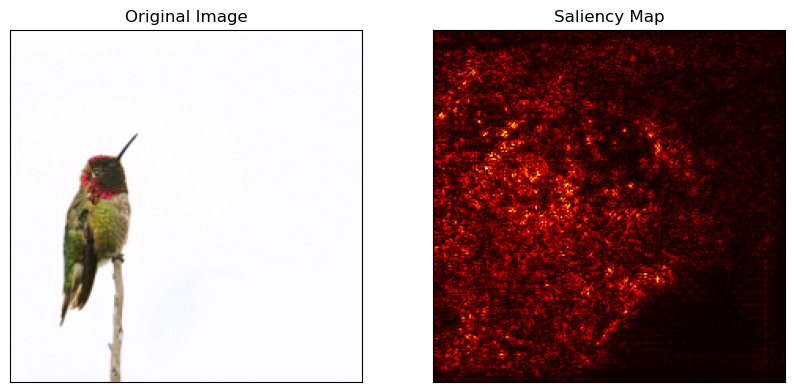

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054133326..1.0792].


Processing indigo finch: Q2/network visualization/indigo finch/indigo finch_1.JPEG


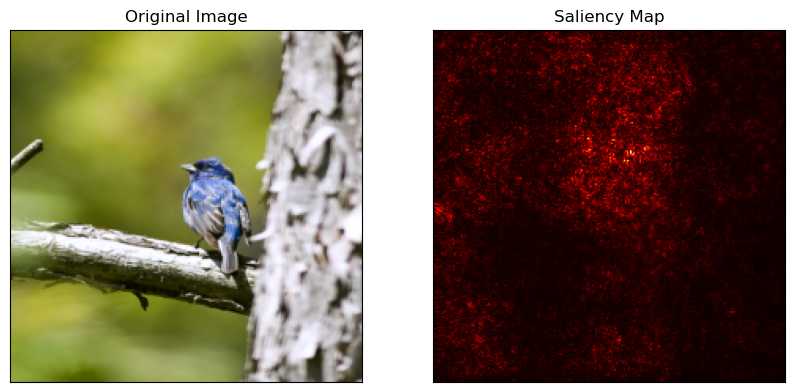

Processing puma: Q2/network visualization/puma/puma_1.JPEG


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.045244444..1.0658667].


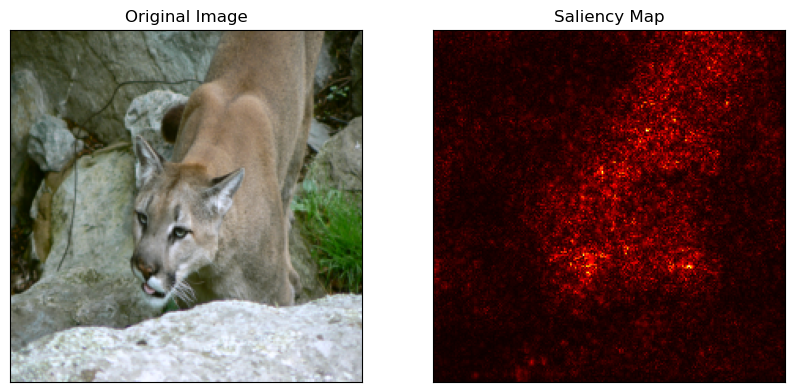

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054133326..1.0792].


Processing red panda: Q2/network visualization/red panda/red panda_1.JPEG


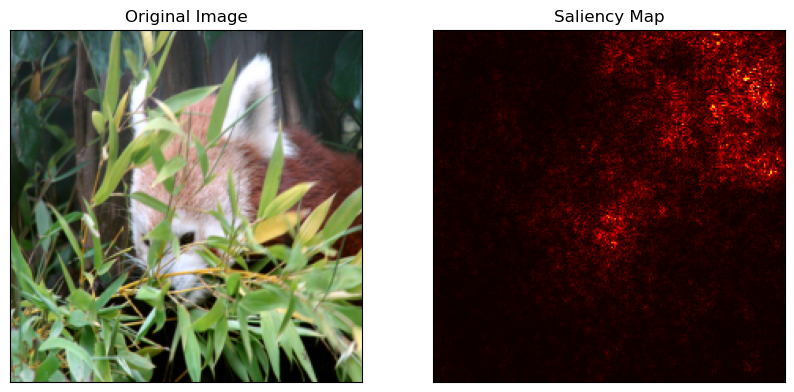

In [21]:
for class_name, img_path in selected_images.items():
    img = Image.open(img_path).convert("RGB")
    print(f"Processing {class_name}: {img_path}")
    saliency(img, resnet18)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6510903..2.58854].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054133326..1.0658667].


Classified as arctic fox with noise level 1.60


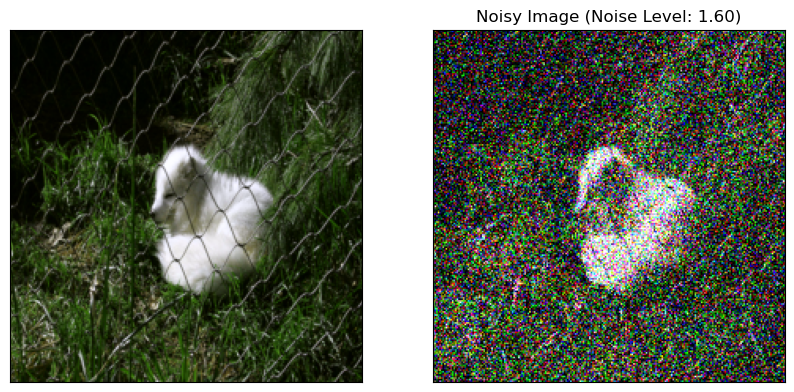

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.6884045..1.6968203].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04079999..1.0792].


Classified as corgi with noise level 0.80


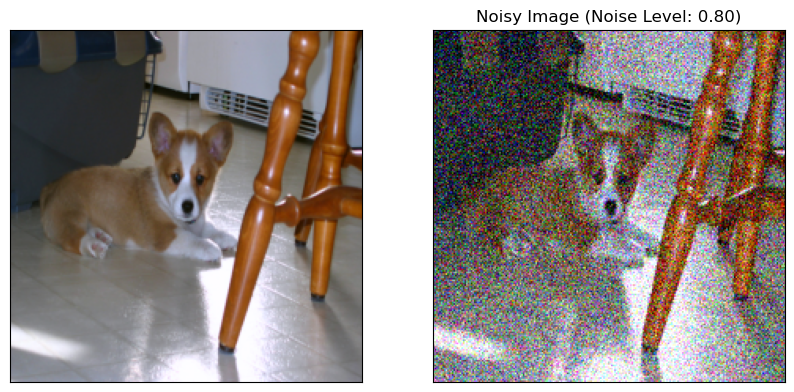

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6330867..2.1134832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054133326..0.6666667].


Classified as electric ray with noise level 1.60


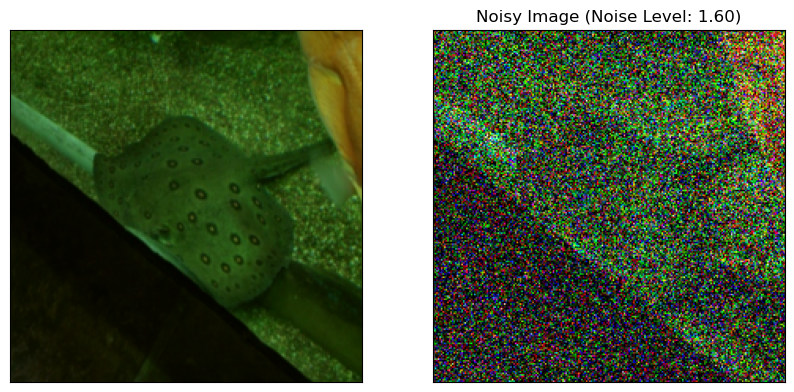

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.2337534..2.1801453].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054133326..1.0792].


Classified as goldfish with noise level 1.20


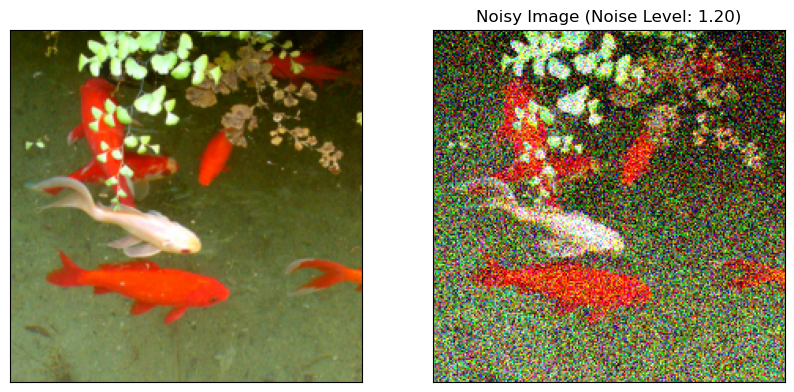

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.1469011..2.2622995].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054133326..1.0614222].


Classified as hammerhead shark with noise level 1.20


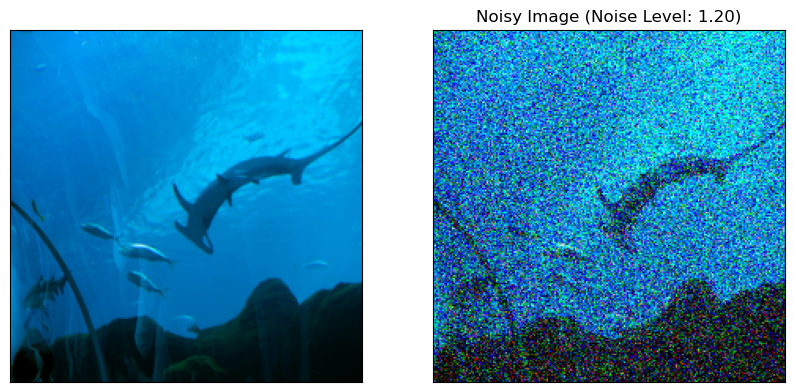

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.2330122..2.275315].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.045244444..1.0792].


Classified as horse with noise level 1.20


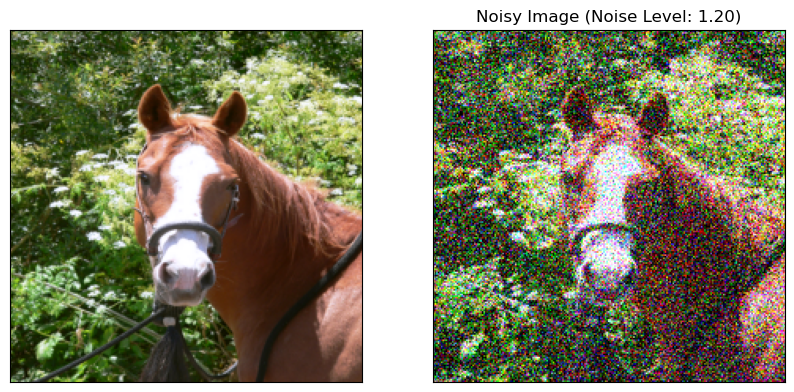

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0336071..2.6490276].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.039200004..1.0792].


Classified as hummingbird with noise level 1.40


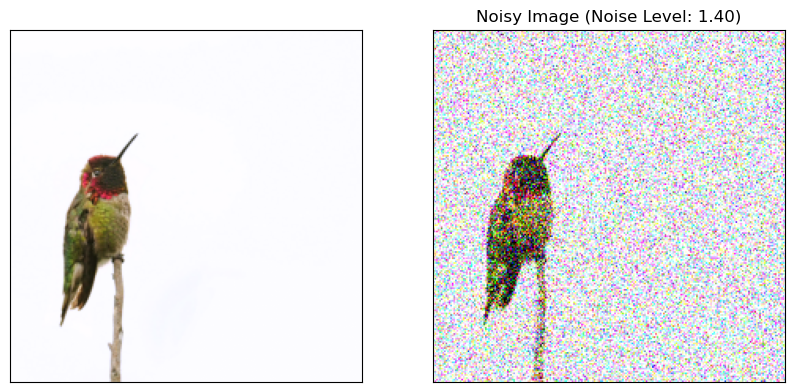

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.697555..2.5011928].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054133326..1.0792].


Classified as indigo finch with noise level 1.60


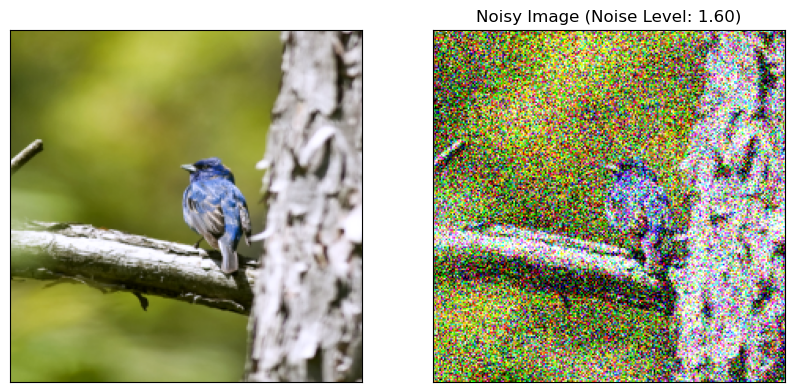

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.77205694..1.7501587].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.045244444..1.0658667].


Classified as puma with noise level 0.80


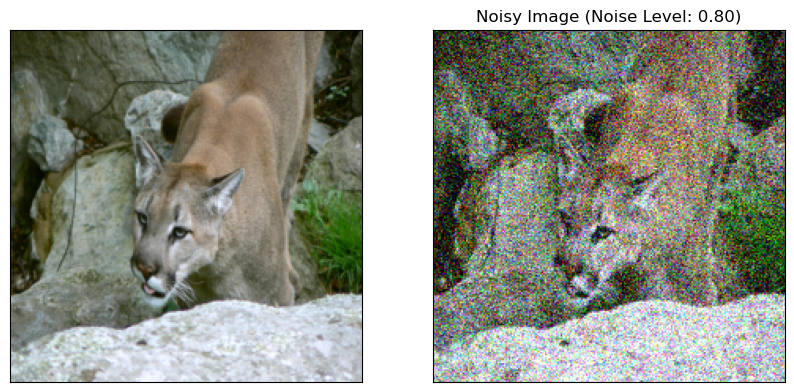

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.5386414..1.5749742].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054133326..1.0792].


Classified as red panda with noise level 0.60


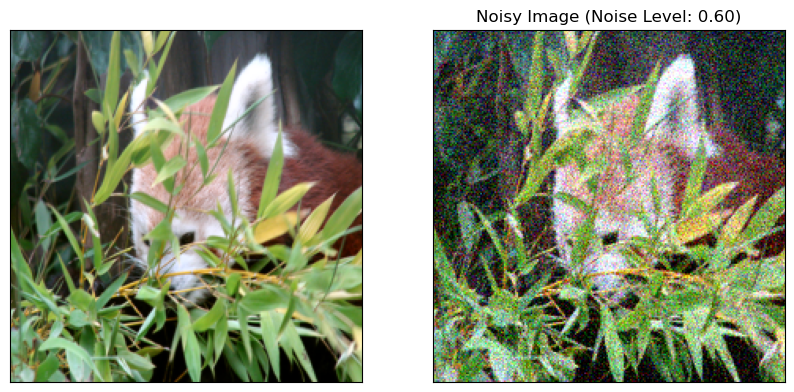

In [22]:
def add_gaussian_noise(input_tensor, mean=0, std=0.1):
    noise = torch.randn_like(input_tensor) * std + mean
    return input_tensor + noise

for class_name, img_path in selected_images.items():
    img = Image.open(img_path).convert("RGB")
    img_tensor = transform(img).unsqueeze(0)
    # Add various amts of noise and classify
    base_class = torch.argmax(resnet18(img_tensor), dim=1).item()
    noise = 0
    curr_class = torch.argmax(resnet18(img_tensor), dim=1).item()
    while curr_class == base_class:
        noise += .2
        noisy_img = add_gaussian_noise(img_tensor, std=noise)
        curr_class = torch.argmax(resnet18(noisy_img), dim=1).item()
    print(f"Classified as {class_name} with noise level {noise:.2f}")
    # plot noisy image and normal image
    noisy_img = inv_normalize(noisy_img[0])
    plt.figure(figsize=(10, 10))
    plt.subplot(1, 2, 2)
    plt.imshow(np.transpose(noisy_img.detach().numpy(), (1, 2, 0)))
    plt.xticks([])
    plt.yticks([])
    plt.title(f"Noisy Image (Noise Level: {noise:.2f})")
    plt.subplot(1, 2, 1)
    plt.imshow(np.transpose(inv_normalize(img_tensor[0]).detach().numpy(), (1, 2, 0)))
    plt.xticks([])
    plt.yticks([])
    plt.show()
        

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9637812..2.1975338].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.2997093..5.832795].


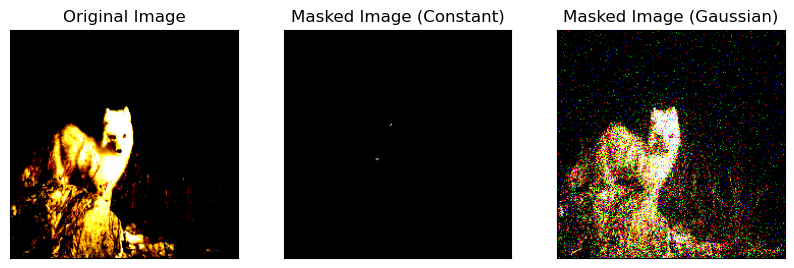

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.39267966..1.3755459].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.6985197..6.1787186].


Masked image with constant noise for arctic fox, m1 class: electric ray, m2 class: arctic fox


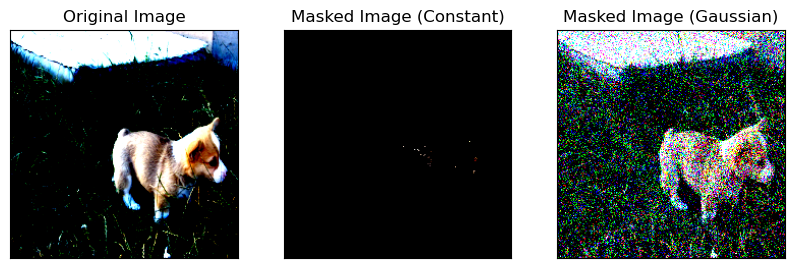

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..2.4285715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..0.55532223].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.3343925..6.008437].


Masked image with constant noise for corgi, m1 class: electric ray, m2 class: arctic fox


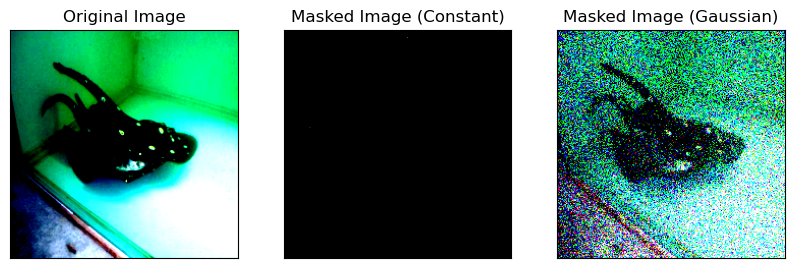

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0182073..2.1632845].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7521569..0.9131775].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.8361263..5.6844683].


Masked image with constant noise for electric ray, m1 class: electric ray, m2 class: electric ray


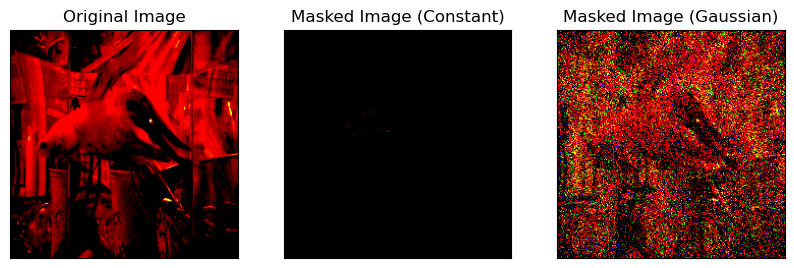

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..0.8796516].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.2264786..6.792655].


Masked image with constant noise for goldfish, m1 class: electric ray, m2 class: electric ray


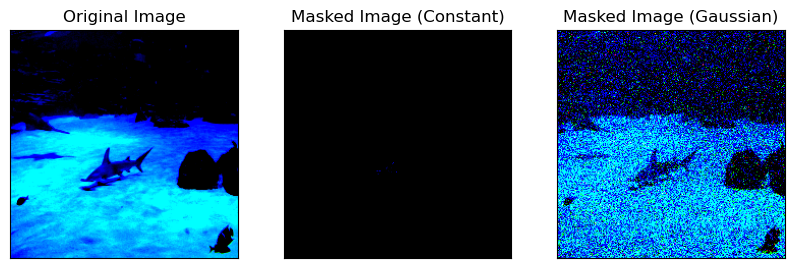

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.3512855..1.7694151].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.5166626..5.9572954].


Masked image with constant noise for hammerhead shark, m1 class: electric ray, m2 class: electric ray


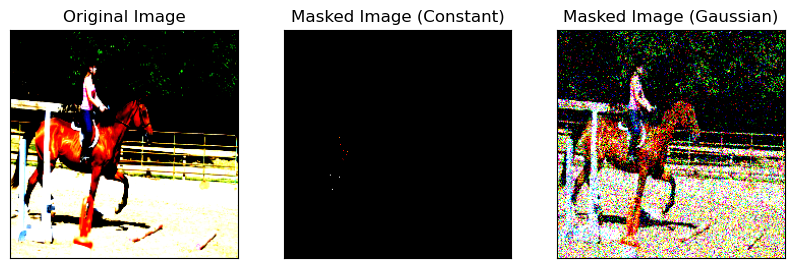

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..0.3277312].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.416527..5.830341].


Masked image with constant noise for horse, m1 class: electric ray, m2 class: horse


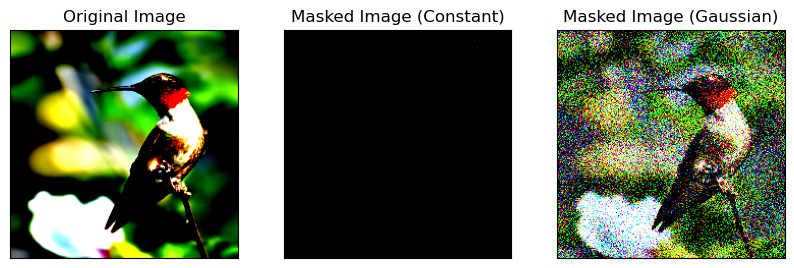

Masked image with constant noise for hummingbird, m1 class: hummingbird, m2 class: hummingbird


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..0.2696297].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.1815467..6.4243374].


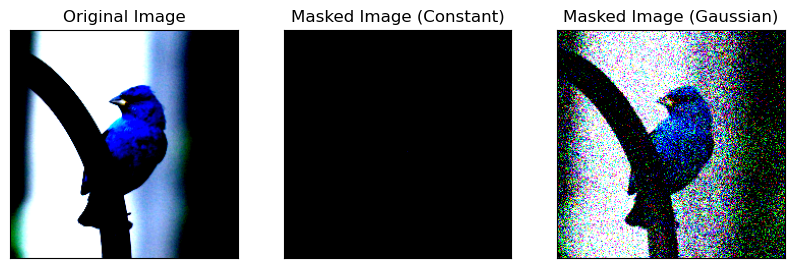

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.5669716..1.2042983].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.0913944..5.321497].


Masked image with constant noise for indigo finch, m1 class: electric ray, m2 class: hammerhead shark


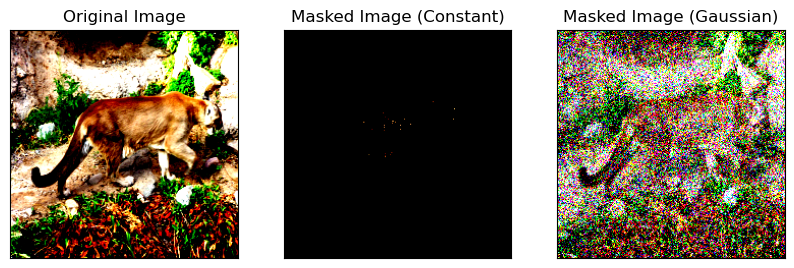

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9637812..0.15968838].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-5.7768893..5.3043633].


Masked image with constant noise for puma, m1 class: electric ray, m2 class: indigo finch


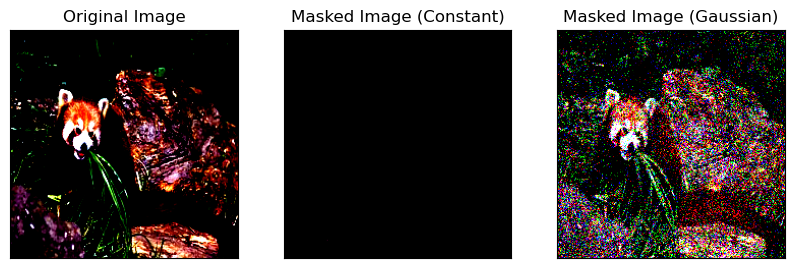

Masked image with constant noise for red panda, m1 class: electric ray, m2 class: electric ray


In [33]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

def mask_salient_pixels(image, saliency, threshold_ratio=0.5, mode='constant'):
    """
    Masks out non-salient pixels from the input image.

    Args:
        image (torch.Tensor): Input image tensor of shape (C, H, W).
        saliency (torch.Tensor): Saliency map tensor of shape (H, W).
        threshold_ratio (float): Fraction of max saliency to use as threshold.
        mode (str): 'constant' to replace with [0,0,0] or 'gaussian' to replace with noise.

    Returns:
        torch.Tensor: Masked image of shape (C, H, W).
    """
    # Compute effective threshold from the maximum saliency value
    effective_threshold = threshold_ratio * saliency.max()
    
    # Create mask: True where pixel saliency is below the threshold
    mask = saliency < effective_threshold  # shape: (H, W)

    # Clone image to avoid in-place modifications
    masked_image = image.clone()
    
    if mode == 'constant':
        # For each channel, set masked pixels to 0 (black)
        masked_image[:, mask] = 0.0
    elif mode == 'gaussian':
        # Apply Gaussian noise only to the thresholded pixels
        noise = torch.randn_like(masked_image)
        masked_image[:, mask] += noise[:, mask]
    elif mode == 'both':
        # For each channel, set masked pixels to 0 (black)
        masked_image[:, mask] = 0.0
        # Generate noise and apply only to thresholded pixels
        masked_image_2 = image.clone()
        noise = torch.randn_like(masked_image_2)
        masked_image_2[:, mask] += noise[:, mask]
        
        # Plot all 3
        plt.figure(figsize=(10, 10))
        plt.subplot(1, 3, 1)
        plt.imshow(np.transpose(image.detach().numpy(), (1, 2, 0)))
        plt.xticks([])
        plt.yticks([])
        plt.title("Original Image")
        
        plt.subplot(1, 3, 2)
        plt.imshow(np.transpose(masked_image.detach().numpy(), (1, 2, 0)))
        plt.xticks([])
        plt.yticks([])
        plt.title("Masked Image (Constant)")
        
        plt.subplot(1, 3, 3)
        plt.imshow(np.transpose(masked_image_2.detach().numpy(), (1, 2, 0)))
        plt.xticks([])
        plt.yticks([])
        plt.title("Masked Image (Gaussian)")
        
        plt.show()
        return masked_image, masked_image_2
    else:
        raise ValueError("Mode must be either 'constant' or 'gaussian'")
    
    plt.figure(figsize=(10, 10))
    plt.subplot(1, 3, 1)
    plt.imshow(np.transpose(image.detach().numpy(), (1, 2, 0)))
    plt.xticks([])
    plt.yticks([])
    plt.title("Original Image")

    plt.subplot(1, 3, 2)
    plt.imshow(saliency.numpy(), cmap=plt.cm.hot)
    plt.xticks([])
    plt.yticks([])
    plt.title("Saliency Map")
    
    plt.subplot(1, 3, 3)
    plt.imshow(np.transpose(masked_image.detach().numpy(), (1, 2, 0)))
    plt.xticks([])
    plt.yticks([])
    plt.title("Masked Image")
    
    return masked_image

for class_name, img_path in selected_images.items():
    img = Image.open(img_path).convert("RGB")
    slc = saliency(img, resnet18, p=False)
    m1, m2 = mask_salient_pixels(transform(img), slc, threshold_ratio=0.7, mode='both')
    print(f"Masked image with constant noise for {class_name}, m1 class: {class_names[torch.argmax(resnet18(m1.unsqueeze(0)), dim=1).item()]}, m2 class: {class_names[torch.argmax(resnet18(m2.unsqueeze(0)), dim=1).item()]}")


In [24]:
dataset_root = "Q2/network visualization"

class_names = sorted(os.listdir(dataset_root))

# Select one image per class
selected_images = {}

for class_name in class_names:
    class_path = os.path.join(dataset_root, class_name)
    
    if not os.path.isdir(class_path):
        print(f"Skipping {class_name}, not a valid directory.")
        continue  # Skip if not a directory

    # taking first image from each class
    expected_filename = f"{class_name}_2.JPEG"  
    expected_path = os.path.join(class_path, expected_filename)

    if os.path.exists(expected_path):
        selected_images[class_name] = expected_path
    else:
        print(f"Warning: {expected_filename} not found in {class_name}, skipping...")

Second Best: red panda


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.5702832].


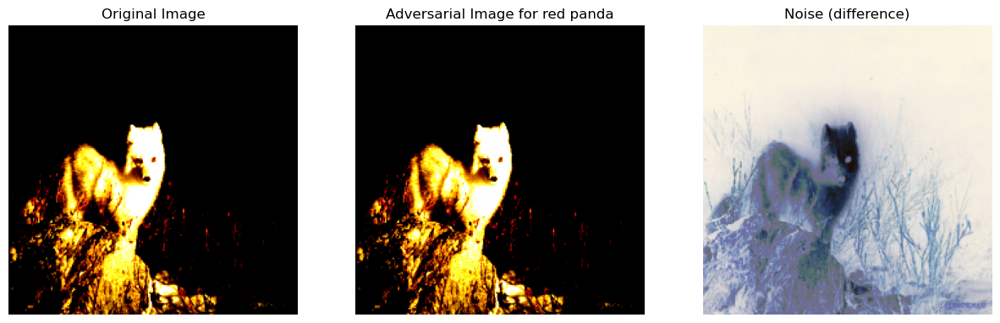

Before Attack: arctic fox | After Attack: electric ray



Second Best: arctic fox


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.622571].


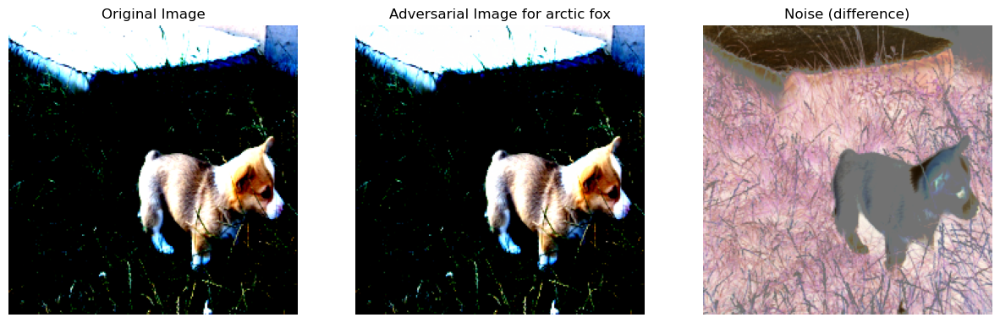

Before Attack: corgi | After Attack: corgi



Second Best: hammerhead shark


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..2.4285715].


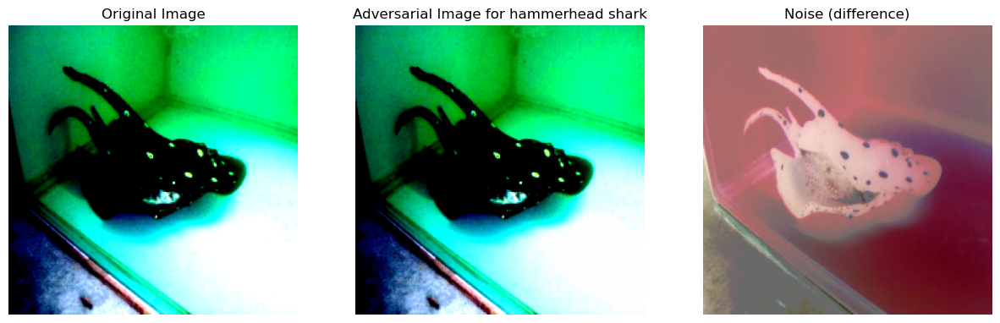

Before Attack: electric ray | After Attack: electric ray



Second Best: hummingbird


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0182073..2.1632845].


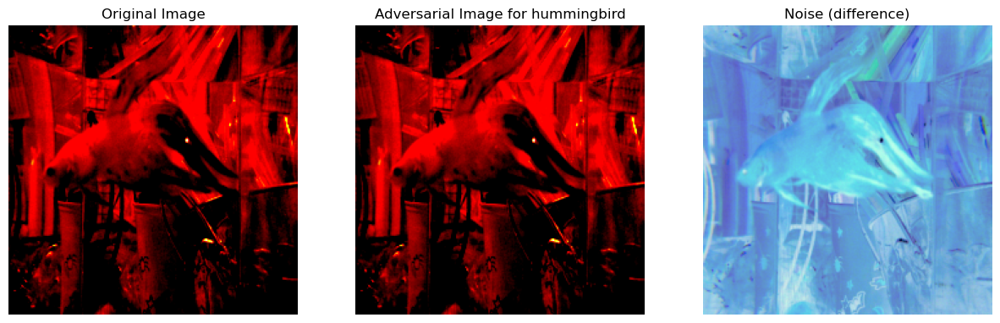

Before Attack: goldfish | After Attack: goldfish



Second Best: electric ray


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].


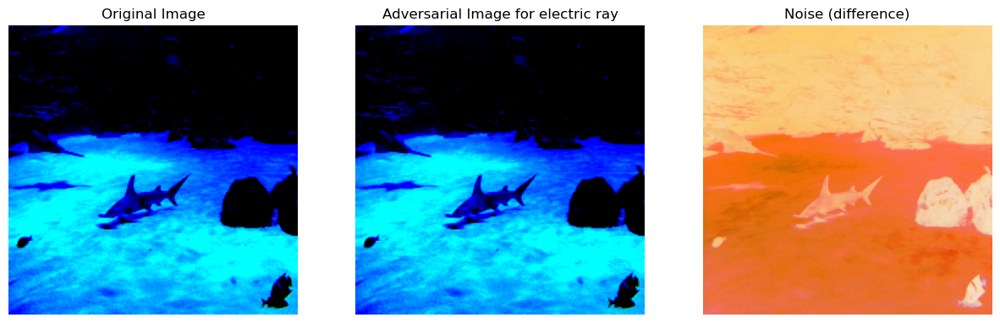

Before Attack: hammerhead shark | After Attack: goldfish



Second Best: corgi


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].


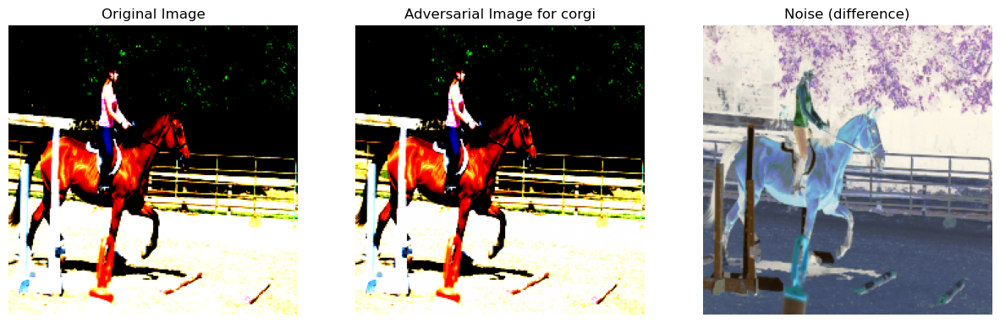

Before Attack: horse | After Attack: horse



Second Best: indigo finch


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.64].


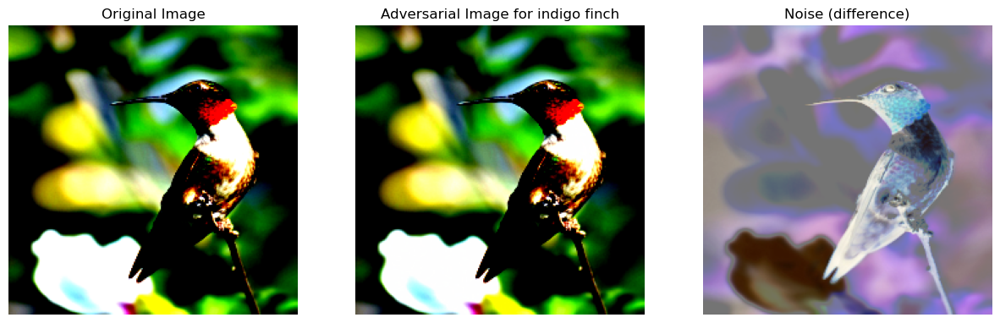

Before Attack: hummingbird | After Attack: hummingbird



Second Best: hummingbird


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.4134207].


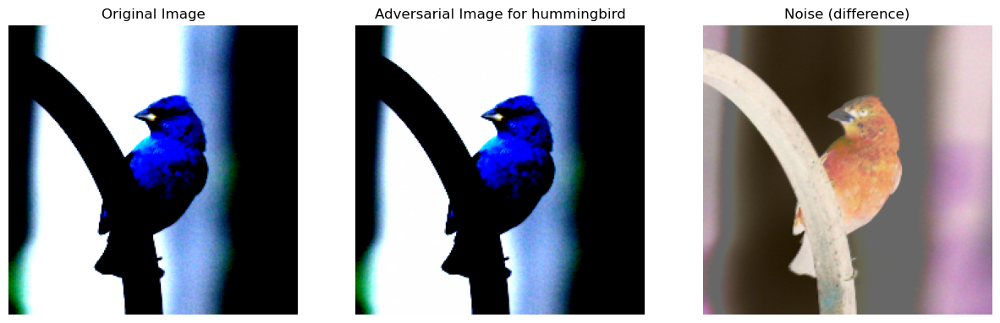

Before Attack: indigo finch | After Attack: hummingbird



Second Best: horse


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..2.6051416].


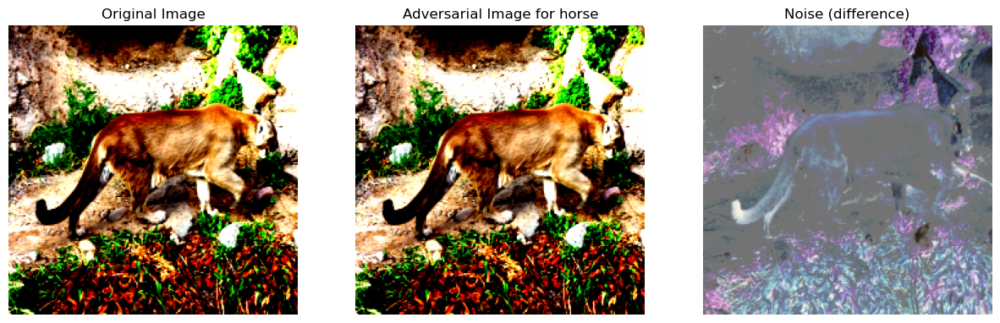

Before Attack: puma | After Attack: puma



Second Best: arctic fox


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


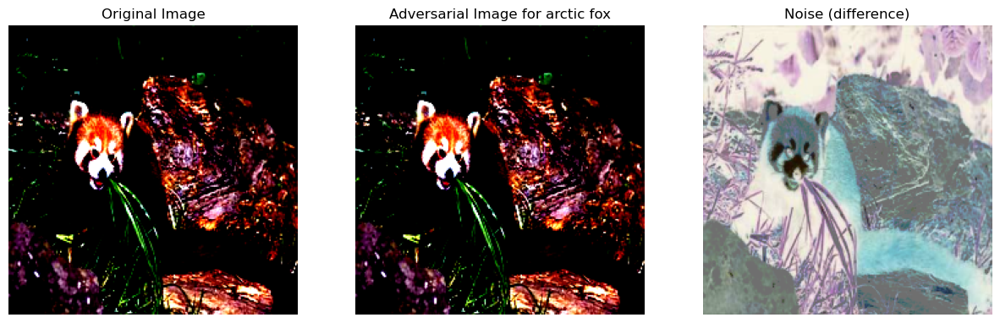

Before Attack: red panda | After Attack: red panda





In [25]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
def add_gaussian_noise(img, std=0.05):
    """
    Adds Gaussian noise with a given standard deviation to the image.
    """
    noise = torch.randn_like(img) * std
    noisy_img = img + noise
    return noisy_img, noise

def adversarial_attack(image, target_class, model, num_steps=100, lr=1e-5):
    """
    Given an image, make it a learnable parameter and optimize it (while freezing the model)
    so that the logit for target_class is maximized.
    """
    # Clone the image and require gradient
    adv_img = image.clone().detach().requires_grad_(True)
    optimizer = optim.Adam([adv_img], lr=lr)
    
    for step in range(num_steps):
        optimizer.zero_grad()
        output = model(adv_img)
        # We want to maximize the logit for target_class, so we minimize its negative.
        loss = -output[0, target_class]
        loss.backward()
        optimizer.step()
        # Optionally clamp the image so that pixel values remain in [0, 1]
        adv_img.data.clamp_(0, 1)
        
    return adv_img.detach()

def show_comparison(original, adv, noise, title_adv):
        fig, axs = plt.subplots(1, 3, figsize=(15,5))
        # Original Image
        axs[0].imshow(original.squeeze().permute(1, 2, 0).cpu().numpy())
        axs[0].set_title("Original Image")
        axs[0].axis('off')
        # Adversarial Image
        axs[1].imshow(adv.squeeze().permute(1, 2, 0).cpu().numpy())
        axs[1].set_title(title_adv)
        axs[1].axis('off')
        # Noise (difference) visualization:
        # Normalize noise for visualization purposes.
        noise_np = noise.squeeze().permute(1, 2, 0).cpu().numpy()
        noise_norm = (noise_np - noise_np.min()) / (noise_np.max() - noise_np.min() + 1e-10)
        axs[2].imshow(noise_norm)
        axs[2].set_title("Noise (difference)")
        axs[2].axis('off')
        plt.show()
        
for class_name, img_path in selected_images.items():
    cl = class_names.index(class_name)
    img = Image.open(img_path).convert("RGB")
    output = resnet18(transform(img).unsqueeze(0))
    logits = torch.nn.functional.softmax(output, dim=1).squeeze()
    second_best = torch.argsort(logits, descending=True)[1].item()
    print(f"Second Best: {class_names[second_best]}")
    adv_img = adversarial_attack(transform(img).unsqueeze(0), second_best, resnet18)
    noise = adv_img - transform(img).unsqueeze(0)
    show_comparison(transform(img), adv_img, noise, f"Adversarial Image for {class_names[second_best]}")
    print(f"Before Attack: {class_names[cl]} | After Attack: {class_names[resnet18(adv_img).argmax(dim=1).item()]}\n\n\n")
    



Original: arctic fox | Least Likely: red panda


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.5702832].


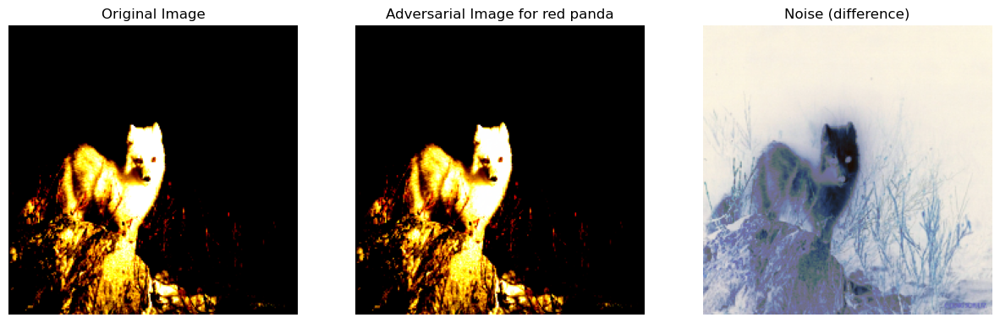

0 2
Original: corgi | Least Likely: arctic fox


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.622571].


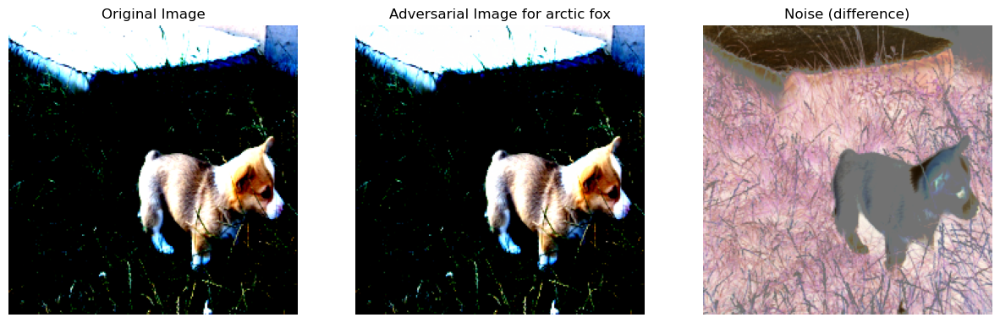

1 1
Original: electric ray | Least Likely: hammerhead shark


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..2.4285715].


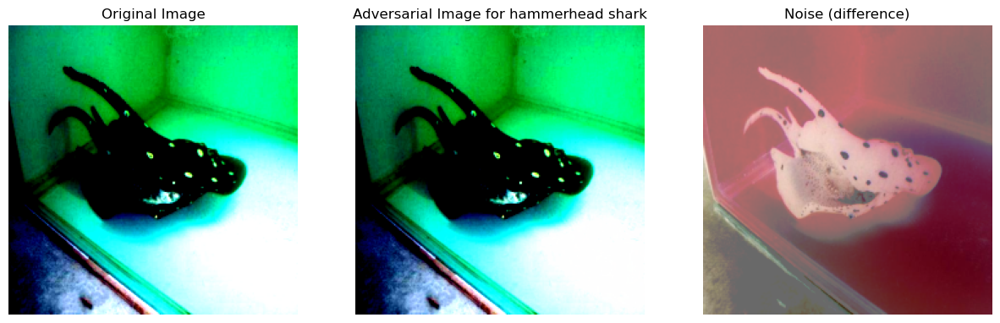

2 2
Original: goldfish | Least Likely: hummingbird


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0182073..2.1632845].


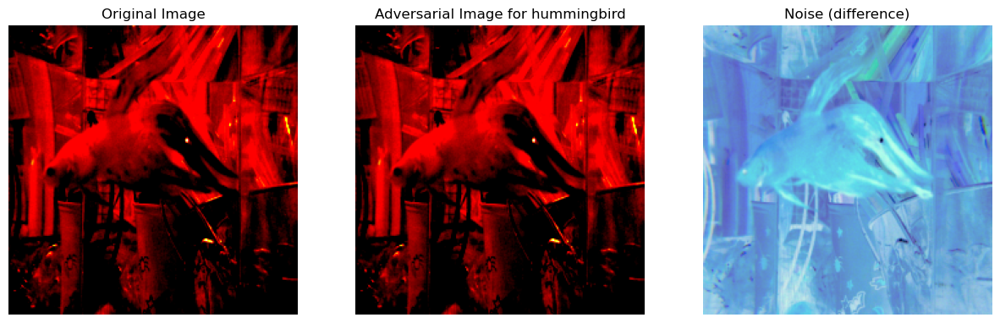

3 3
Original: hammerhead shark | Least Likely: electric ray


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].


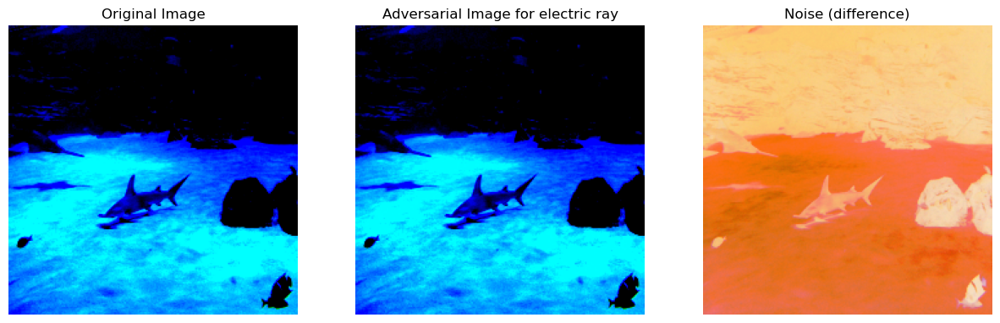

4 3
Original: horse | Least Likely: corgi


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].


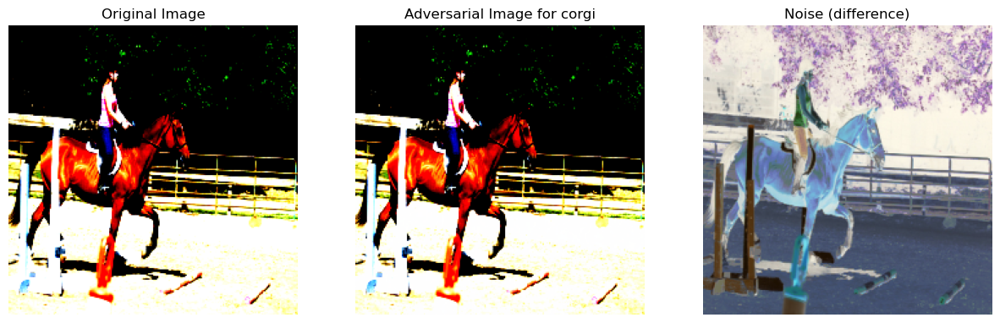

5 5
Original: hummingbird | Least Likely: indigo finch


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.64].


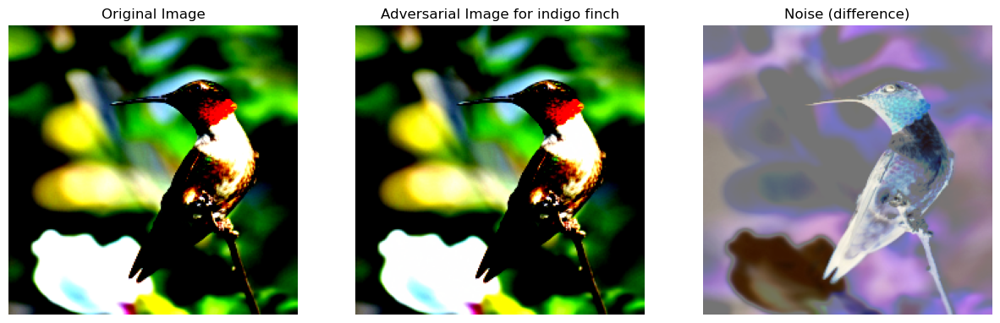

6 6
Original: indigo finch | Least Likely: hummingbird


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.4134207].


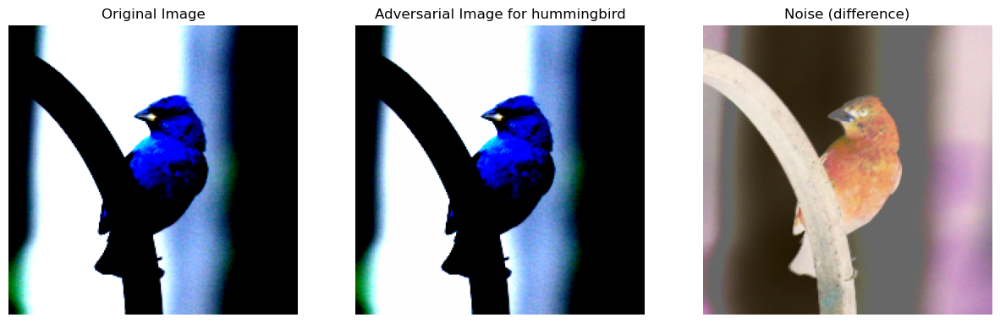

7 6
Original: puma | Least Likely: horse


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..2.6051416].


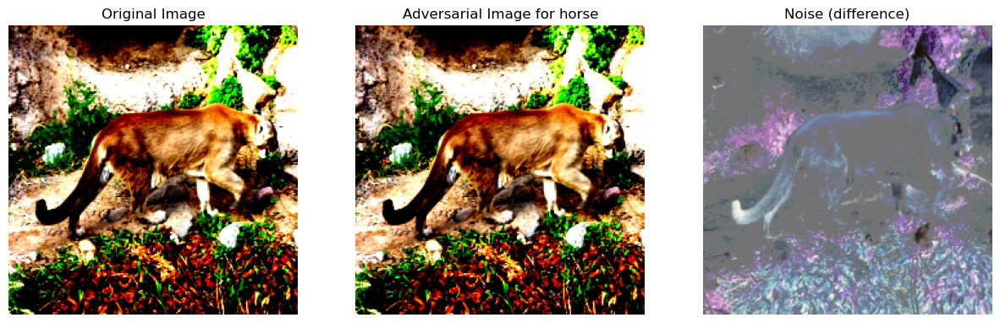

8 8
Original: red panda | Least Likely: arctic fox


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


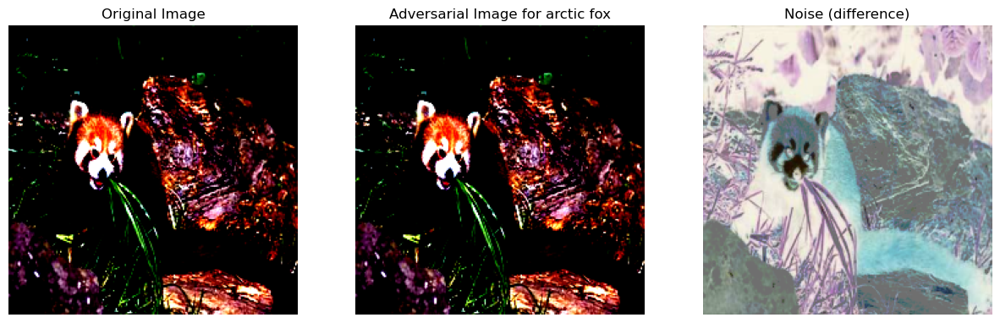

9 9


In [26]:
for class_name, img_path in selected_images.items():   
    cl = class_names.index(class_name)
    img = Image.open(img_path).convert("RGB")
    output = resnet18(transform(img).unsqueeze(0))
    logits = torch.nn.functional.softmax(output, dim=1).squeeze()
    least_likely = torch.argsort(logits, descending=True)[1].item()
    print(f"Original: {class_names[cl]} | Least Likely: {class_names[least_likely]}")
    adv_img = adversarial_attack(transform(img).unsqueeze(0), second_best, resnet18)
    noise = adv_img - transform(img).unsqueeze(0)
    show_comparison(transform(img), adv_img, noise, f"Adversarial Image for {class_names[least_likely]}")
    print(f"{resnet18(transform(img).unsqueeze(0)).argmax(dim=1).item()} {resnet18(adv_img).argmax(dim=1).item()}") 

# Analysis
- classes stay unchanged for images iwth masking on pixels with low saliency suggesting these pixels have lower contribution to the classification